
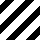
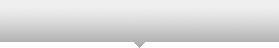
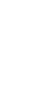
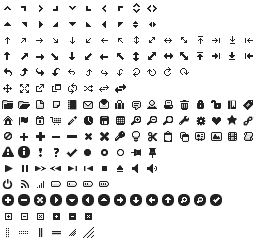
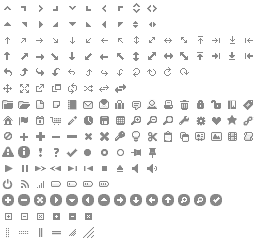
...
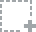
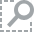
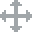
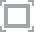
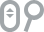

In [56]:
from derivation import *
from integration import *
from file_helpers import *
from plot_helpers import *
output_notebook()

In [57]:
from IPython.display import display, Javascript

disable_js = """
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}
"""

def load_ipython_extension(ip):
    display(Javascript(disable_js))
    print ("autoscrolling long output is disabled")
    
load_ipython_extension(disable_js)

<IPython.core.display.Javascript object>

autoscrolling long output is disabled


In [58]:
fnames = get_files()
data = clean_file('29.txt')
temp, heat_flow = np.array(data.temp), np.array(data.heat_flow)

In [59]:
#generate_summary_plot()

# Splines

In [60]:
from scipy.interpolate import UnivariateSpline

In [92]:
[a for a in xrange(10, 1, -1)]

[10, 9, 8, 7, 6, 5, 4, 3, 2]

In [101]:
def plot_poly(x, y, n):
    coefs = np.polyfit(x, y, deg = n)
    arr = np.zeros(x.shape)
    for i in xrange(n, 1, -1):
        arr += coefs[i-1] * x**i
    p = figure()
    p.line(temp, arr)
    show(p)
    return arr
        
        

In [108]:
bad_files = []
for f in get_files():
    try:
        data = clean_file(f)
        temp, heat_flow = -data.temp, data.heat_flow

        s1 = UnivariateSpline(temp, heat_flow, k = 1)
        s2 = UnivariateSpline(temp, heat_flow, k = 2)
        s3 = UnivariateSpline(temp, heat_flow, k = 3)
        s4 = UnivariateSpline(temp, heat_flow, k = 4)
        s5 = UnivariateSpline(temp, heat_flow, k = 5)
        cumu = s2(temp) + s3(temp) + s4(temp) + s5(temp)
        d2 = get_second_derivative(temp, cumu)
        d5 = s5.derivative(2)

        p = figure(title = f)

        p.extra_y_ranges = {'d2': Range1d(start = np.min(d2[100:]), end = np.max(d2[100:]))}
        p.add_layout(LinearAxis(y_range_name = 'd2'), 'right')
        p.line(temp, d5(temp), y_range_name = 'd2', color = 'purple', legend = 'spline 5 deriv')
        p.line(temp, d2/3, y_range_name = 'd2', color = 'red', legend = '2nd derivative of Spline')
#         p.line(temp, cumu + 10, legend = 'Spline estimate')
        p.line(temp, heat_flow, color = 'black', legend = 'raw data, shifted', line_dash = 'dashed')
        
        show(p)
    except:
        bad_files.append(f)

In [114]:

from scipy.signal import argrelextrema

In [151]:
mins = argrelextrema(s, np.less)[0]
maxs = argrelextrema(s, np.greater)[0]

In [152]:
temp, heat_flow = np.array(temp), np.array(heat_flow)

In [153]:
from scipy.interpolate import UnivariateSpline

In [154]:
s = UnivariateSpline(temp, heat_flow, k = 5).derivative(2)(temp)

In [156]:
mins

array([   1,    4,    8, 1405])

In [155]:
p = figure()
p.extra_y_ranges = {'d': Range1d(start = np.min(s), end = np.max(s))}
p.add_layout(LinearAxis(y_range_name = 'd'), 'right')

p.line(temp, s, y_range_name = 'd')
p.line(temp, heat_flow)
p.scatter(temp[mins], heat_flow[mins], color = 'red')
p.scatter(temp[maxs], heat_flow[maxs], color = 'green')

show(p)

In [236]:
start_point = 0

s_t, s_h = temp[start_point:], heat_flow[start_point:]

approx = UnivariateSpline(s_t, s_h, k = 5)
s_2 = approx.derivative(2)(s_t)

p = figure()
p.extra_y_ranges = {'d': Range1d(start = np.min(s_2), end = np.max(s_2))}
p.add_layout(LinearAxis(y_range_name = 'd'), 'right')

p.line(s_t, approx(s_t), color = 'red', legend = 'approximation')
p.line(s_t, s_2, y_range_name = 'd', color = 'green', legend = 'second derivative')
p.line(s_t, 0, y_range_name = 'd')
p.line(temp[start_point:], heat_flow[start_point:], legend = 'actual')
show(p)

In [252]:
coefficients = np.polyfit(temp, heat_flow, 5)
polynomial = np.poly1d(coefficients)
xs = np.arange(40, 100, 0.1)
ys = polynomial(xs)
d = get_second_derivative(xs, ys)

p = figure()
p.extra_y_ranges = {'d': Range1d(start = np.min(d), end = np.max(d))}
p.add_layout(LinearAxis(y_range_name = 'd'), 'right')

p.line(temp, heat_flow)
p.line(xs, ys, color = 'red', legend = 'approx')
p.line(xs, d*5, color = 'green', legend = '2d')
show(p)

In [399]:
import numpy as np

from scipy.interpolate import UnivariateSpline
from scipy.signal import argrelextrema


def get_spline(X, y):
    """
    Given a typical reaction, this returns a smoothed approximation of the reaction.
    """
    output = np.zeros(X.shape)
    for deg in xrange(1, 5):
        s = UnivariateSpline(X, y, deg)
        output += s(X)
    return output

def find_onset_point(X, y):
    """

    In order, this function:

    1. Smooths the data and approximates it with a spline.

    2. Finds the second derivative.

    3. Finds where the second derivative of the approximation is minimized,
    which in this data coincides with just before the reaction begins.
    That point is the starting point for the reaction.

    """
    second_derivative = UnivariateSpline(X, y, k = 5).derivative(2)(X)

    local_minima = argrelextrema(second_derivative, np.less)[0]
    relevant_minima_points = local_minima[local_minima > 100] # crop off the first tail

    start_point_id = relevant_minima_points[0] # take the first relevant point

    return start_point_id

def find_ending_point(X, y, start_point):
    """
    
    Use this once you find the starting point.

    In order, this function:

    1. Isolates data after the reaction has started, which is more or less
    a fat-tailed normal distribution

    2. Approximates the data with a spline.

    3. Finds the point where the first derivative is closest to zero and nearest
    to the end of the reaction. This is the end point.
        ## note, you could also set the end point to be when the function has returned closest
        ## to the gradient at the start_point

    """
    reaction_x = X[start_point:] # x's after the start_point
    reaction_y = y[start_point:] # y's after the start_point

    spline = UnivariateSpline(reaction_x, reaction_y, k = 5)
    first_derivative = spline.derivative(1)(reaction_x) # find where dy/dx^2 = 0
    second_derivative = spline.derivative(2)(reaction_x)

    relevant_end_points = np.abs(second_derivative)
    end_point = np.max(relevant_end_points.argsort()[:50])# get the largest of all the zero points
    end_point_id = len(X) - end_point #end point is measured as points from end of experiment

    return start_point + end_point_id


In [400]:
find_ending_point(temp, heat_flow, 1405)

3364

In [397]:
%matplotlib inline

In [398]:
for f in get_files():
    try:
        data = clean_file(f)
        temp, heat_flow = np.array(data.temp), np.array(data.heat_flow)
        onset_point = find_onset_point(temp, heat_flow)
        end_point = find_ending_point(temp, heat_flow, onset_point)
        l_X, l_y = construct_line(temp[onset_point],
                              heat_flow[onset_point],
                              temp[end_point],
                              heat_flow[end_point],
                              temp[onset_point:end_point]
                             )

        X, y = temp, heat_flow
        reaction_x = X[start_point:] # x's after the start_point
        reaction_y = y[start_point:] # y's after the start_point
        spline = UnivariateSpline(reaction_x, reaction_y, k = 5)
        d = spline.derivative(1)(reaction_x) # find where d^2y/dx^2 = 0
        p = figure(title = f)
        p.extra_y_ranges = {'d': Range1d(start = np.min(d), end = np.max(d))}
        p.add_layout(LinearAxis(y_range_name = 'd'), 'right')

    #         p.line(reaction_x, spline(reaction_x))
    #         p.line(reaction_x, d, color = 'red', y_range_name = 'd')
        p.line(temp, heat_flow)
        p.line(l_X, l_y, color = 'green')
        p.scatter(temp[onset_point], heat_flow[onset_point], color = 'red')
        p.scatter(temp[end_point], heat_flow[end_point], color = 'red')
        
        differences = heat_flow[onset_point : end_point] - l_y
        p.line()
        
        show(p)
  
    except:
        bad_files.append(f)